# 00_exploratory_data_analysis.ipynb

**Project**: Lumbar Spine Degenerative Classification  
**Description**: This notebook performs exploratory data analysis (EDA) on the raw and label data: inspecting table structures, visualizing coordinate & class distributions, and sampling MR-image visualizations.

---

## Table of Contents
1. [Environment and Imports](#section1)
2. [Data Ingestion & Consolidation](#section2)
3. [Coordinate Distributions](#section3)
4. [Density by Condition (hexbin)](#section4)
5. [Density by Level (hexbin)](#section5)
6. [Density by Series Description (hexbin)](#section6)
7. [Target Distribution (pie & bar)](#section7)
8. [Sample MR-Image Overlays](#section8)
9. [3D MR Slide Animation](#section9)


<a id="section1"></a>
## 1. Environment and Imports

In [1]:
import numpy as np
import pandas as pd
import os
import time
import matplotlib.pyplot as plt
from matplotlib import animation, rc
import plotly.express as px
import seaborn as sns
import cv2
import pydicom
from pydicom.pixel_data_handlers.util import apply_voi_lut
import warnings
warnings.filterwarnings('ignore')
import glob
import json
import collections
import sys
from IPython.display import display


# Change working directory to project root
if os.path.basename(os.getcwd()) == "notebooks":
    os.chdir("..")

# Path adjustments for custom modules (if not already on sys.path).
module_path = os.path.abspath(os.path.join("src"))
if module_path not in sys.path:
    sys.path.append(module_path)

print("Environment diagnostics:")
print(f"  Working directory : {os.getcwd()}")
print(f"  Python executable : {sys.executable}")

Environment diagnostics:
  Working directory : /home/jkskw/git/ml_lumbar_mri
  Python executable : /home/jkskw/git/ml_lumbar_mri/venv/bin/python


<a id="section2"></a>
## 2. Data Ingestion & Consolidation

In [2]:
path = 'data/raw/'
df_train_main  = pd.read_csv(path + 'train.csv')
df_train_label = pd.read_csv(path + 'train_label_coordinates.csv')
df_train_desc  = pd.read_csv(path + 'train_series_descriptions.csv')
df_test_desc   = pd.read_csv(path + 'test_series_descriptions.csv')
df_sub         = pd.read_csv(path + 'sample_submission.csv')

In [3]:
# Summary of main DataFrame
summary_main = pd.DataFrame({
    "Column": df_train_main.columns,
    "Non-Null Count": df_train_main.notna().sum().values,
})
print("Summary of df_train_main:")
display(summary_main.style.hide())

# Show first three rows of main DataFrame
print("\nFirst 3 rows of df_train_main:")
display(df_train_main.head(3).style.hide())

# Summary of label DataFrame
summary_label = pd.DataFrame({
    "Column": df_train_label.columns,
    "Non-Null Count": df_train_label.notna().sum().values,
})
print("\nSummary of df_train_label:")
display(summary_label.style.hide())

# Show first three rows of label DataFrame
print("\nFirst 3 rows of df_train_label:")
display(df_train_label.head(3).style.hide())

# Display value counts for key columns
for col in ['instance_number', 'condition', 'level']:
    print(f"\nValue counts for {col}:")
    vc = (
        df_train_label[col]
        .value_counts()
        .reset_index()
        .rename(columns={'index': col, col: 'count'})
    )
    display(vc.style.hide())


Summary of df_train_main:


Column,Non-Null Count
study_id,1975
spinal_canal_stenosis_l1_l2,1974
spinal_canal_stenosis_l2_l3,1974
spinal_canal_stenosis_l3_l4,1974
spinal_canal_stenosis_l4_l5,1974
spinal_canal_stenosis_l5_s1,1974
left_neural_foraminal_narrowing_l1_l2,1973
left_neural_foraminal_narrowing_l2_l3,1973
left_neural_foraminal_narrowing_l3_l4,1973
left_neural_foraminal_narrowing_l4_l5,1973



First 3 rows of df_train_main:


study_id,spinal_canal_stenosis_l1_l2,spinal_canal_stenosis_l2_l3,spinal_canal_stenosis_l3_l4,spinal_canal_stenosis_l4_l5,spinal_canal_stenosis_l5_s1,left_neural_foraminal_narrowing_l1_l2,left_neural_foraminal_narrowing_l2_l3,left_neural_foraminal_narrowing_l3_l4,left_neural_foraminal_narrowing_l4_l5,left_neural_foraminal_narrowing_l5_s1,right_neural_foraminal_narrowing_l1_l2,right_neural_foraminal_narrowing_l2_l3,right_neural_foraminal_narrowing_l3_l4,right_neural_foraminal_narrowing_l4_l5,right_neural_foraminal_narrowing_l5_s1,left_subarticular_stenosis_l1_l2,left_subarticular_stenosis_l2_l3,left_subarticular_stenosis_l3_l4,left_subarticular_stenosis_l4_l5,left_subarticular_stenosis_l5_s1,right_subarticular_stenosis_l1_l2,right_subarticular_stenosis_l2_l3,right_subarticular_stenosis_l3_l4,right_subarticular_stenosis_l4_l5,right_subarticular_stenosis_l5_s1
4003253,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild
4646740,Normal/Mild,Normal/Mild,Moderate,Severe,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Moderate,Normal/Mild,Normal/Mild,Moderate,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Severe,Normal/Mild,Normal/Mild,Moderate,Moderate,Moderate,Normal/Mild
7143189,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild



Summary of df_train_label:


Column,Non-Null Count
study_id,48692
series_id,48692
instance_number,48692
condition,48692
level,48692
x,48692
y,48692



First 3 rows of df_train_label:


study_id,series_id,instance_number,condition,level,x,y
4003253,702807833,8,Spinal Canal Stenosis,L1/L2,322.831858,227.964602
4003253,702807833,8,Spinal Canal Stenosis,L2/L3,320.571429,295.714286
4003253,702807833,8,Spinal Canal Stenosis,L3/L4,323.030303,371.818182



Value counts for instance_number:


count,count
8,3615
11,3517
10,3396
5,3288
12,3180
13,3155
9,3107
6,3060
4,3060
7,2449



Value counts for condition:


count,count
Left Neural Foraminal Narrowing,9860
Right Neural Foraminal Narrowing,9859
Spinal Canal Stenosis,9753
Right Subarticular Stenosis,9612
Left Subarticular Stenosis,9608



Value counts for level:


count,count
L3/L4,9858
L4/L5,9858
L5/S1,9845
L2/L3,9661
L1/L2,9470


In [4]:
# Merging Tables
df_train_step_1 = pd.merge(df_train_label, df_train_main, on='study_id', how='left').reset_index(drop=True)
df_train = pd.merge(df_train_step_1, df_train_desc, on=['study_id', 'series_id'], how='left').reset_index(drop=True)
df_train.study_id = df_train.study_id.astype('category')
df_train.series_id = df_train.series_id.astype('category')

# Display first rows of merged DataFrame
print("\nFirst 5 rows after merging:")
display(df_train.head().style.hide())


First 5 rows after merging:


study_id,series_id,instance_number,condition,level,x,y,spinal_canal_stenosis_l1_l2,spinal_canal_stenosis_l2_l3,spinal_canal_stenosis_l3_l4,spinal_canal_stenosis_l4_l5,spinal_canal_stenosis_l5_s1,left_neural_foraminal_narrowing_l1_l2,left_neural_foraminal_narrowing_l2_l3,left_neural_foraminal_narrowing_l3_l4,left_neural_foraminal_narrowing_l4_l5,left_neural_foraminal_narrowing_l5_s1,right_neural_foraminal_narrowing_l1_l2,right_neural_foraminal_narrowing_l2_l3,right_neural_foraminal_narrowing_l3_l4,right_neural_foraminal_narrowing_l4_l5,right_neural_foraminal_narrowing_l5_s1,left_subarticular_stenosis_l1_l2,left_subarticular_stenosis_l2_l3,left_subarticular_stenosis_l3_l4,left_subarticular_stenosis_l4_l5,left_subarticular_stenosis_l5_s1,right_subarticular_stenosis_l1_l2,right_subarticular_stenosis_l2_l3,right_subarticular_stenosis_l3_l4,right_subarticular_stenosis_l4_l5,right_subarticular_stenosis_l5_s1,series_description
4003253,702807833,8,Spinal Canal Stenosis,L1/L2,322.831858,227.964602,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Sagittal T2/STIR
4003253,702807833,8,Spinal Canal Stenosis,L2/L3,320.571429,295.714286,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Sagittal T2/STIR
4003253,702807833,8,Spinal Canal Stenosis,L3/L4,323.030303,371.818182,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Sagittal T2/STIR
4003253,702807833,8,Spinal Canal Stenosis,L4/L5,335.292035,427.327434,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Sagittal T2/STIR
4003253,702807833,8,Spinal Canal Stenosis,L5/S1,353.415929,483.964602,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Moderate,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Normal/Mild,Sagittal T2/STIR


<a id="section3"></a>
## 3. Coordinate Distributions

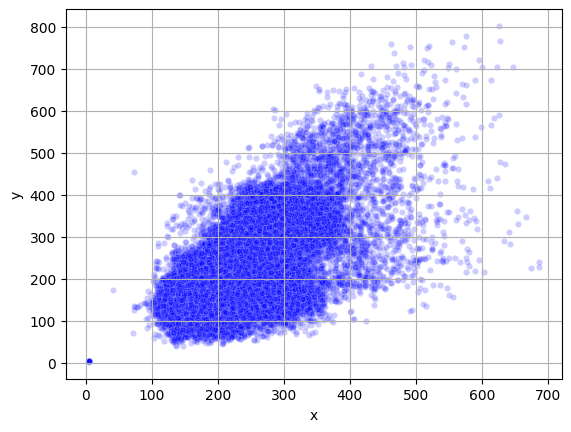

In [5]:
# Coordinate Distributions
sns.scatterplot(data=df_train, x='x', y='y', color='blue', s=20, alpha=0.2)
plt.grid()
plt.show()

<a id="section4"></a>
## 4. Density by Condition

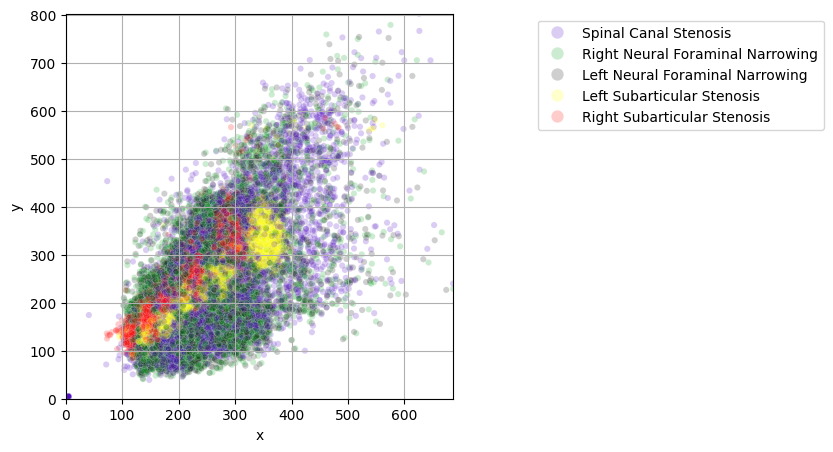

In [6]:
# Density Plots by Condition
p = ['#4600c0','#00a419','#111111','#ffff00','#ff0000']
plt.figure(figsize=(5,5))
sns.scatterplot(data=df_train, x='x', y='y', hue='condition', palette=p, s=20, alpha=0.2)
plt.legend(bbox_to_anchor=(1.2,1), loc=2, prop={'size':10}, markerscale=2, framealpha=0.8, facecolor='white')
plt.grid()
plt.xlim(0, df_train.x.max())
plt.ylim(0, df_train.y.max())
plt.show()

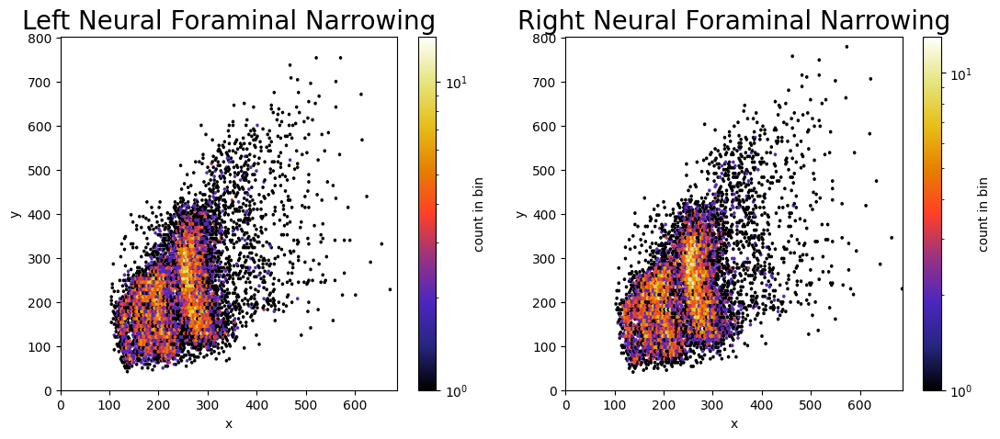

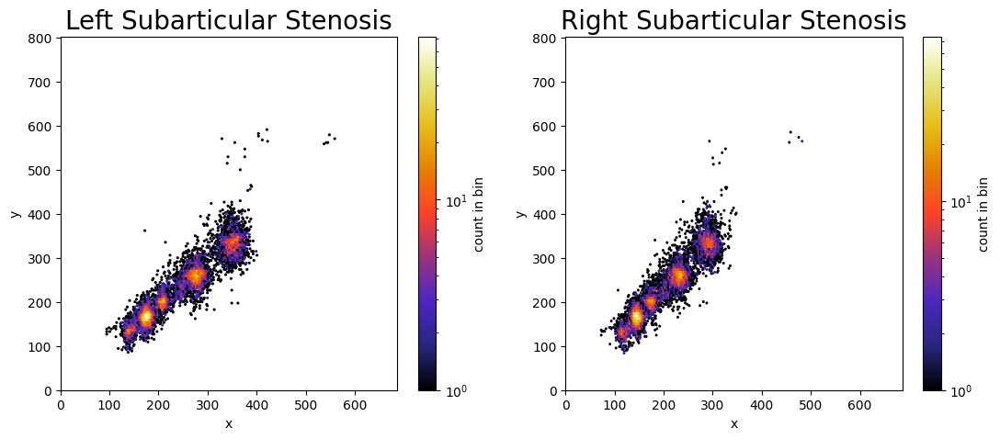

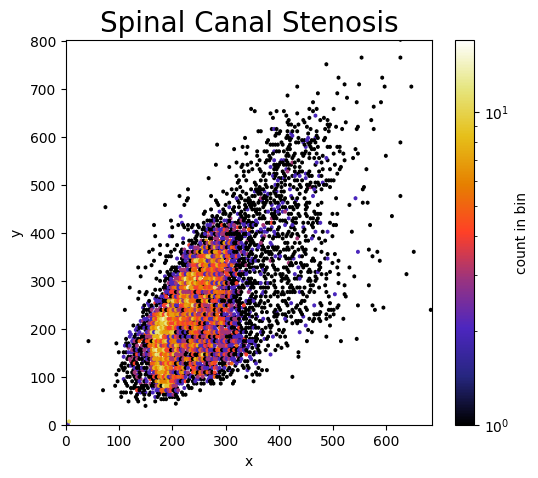

In [7]:
# Density Hexbin Plot by Condition
numerical_features = [
    'Left Neural Foraminal Narrowing',
    'Right Neural Foraminal Narrowing',
    'Left Subarticular Stenosis',
    'Right Subarticular Stenosis',
    'Spinal Canal Stenosis'
]
figs_x, figs_y, gs, n = 13, 5, 150, 2
Label_size, Title_size = 10, 20
plt.figure(figsize=(figs_x, figs_y))
k = 1
for feat in numerical_features:
    d = df_train[df_train.condition == feat]
    plt.subplot(1, n, k)
    plt.hexbin(x=d.x, y=d.y, gridsize=gs, cmap='CMRmap', bins='log', alpha=1)
    plt.colorbar().set_label('count in bin', size=10)
    plt.xlabel('x', fontsize=Label_size)
    plt.ylabel('y', fontsize=Label_size)
    plt.title(feat, fontsize=Title_size)
    plt.xlim(0, df_train.x.max())
    plt.ylim(0, df_train.y.max())
    k += 1
    if k > n:
        plt.show()
        plt.figure(figsize=(figs_x, figs_y))
        k = 1

<a id="section5"></a>
## 5. Density by Level

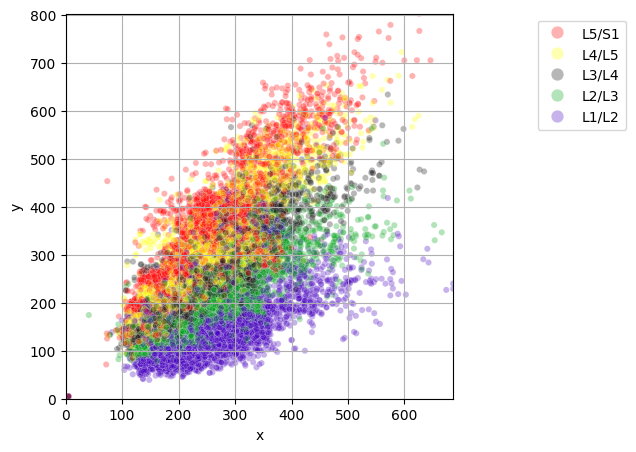

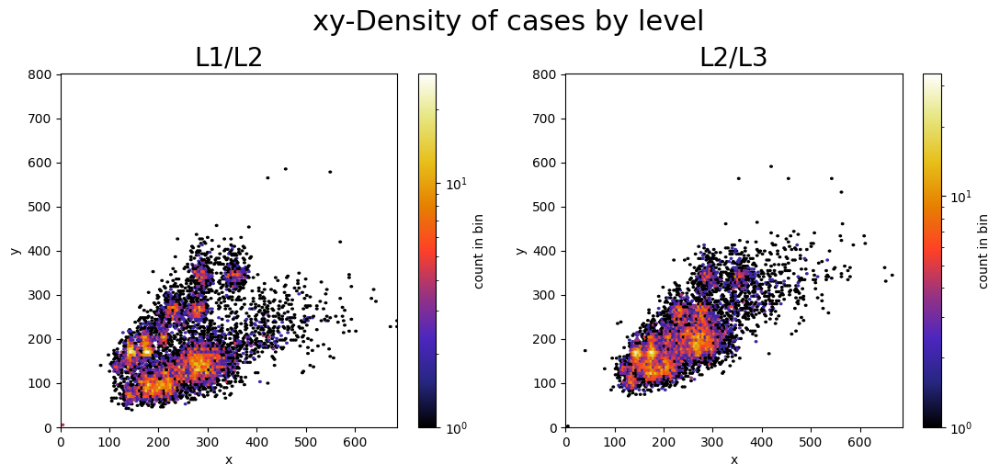

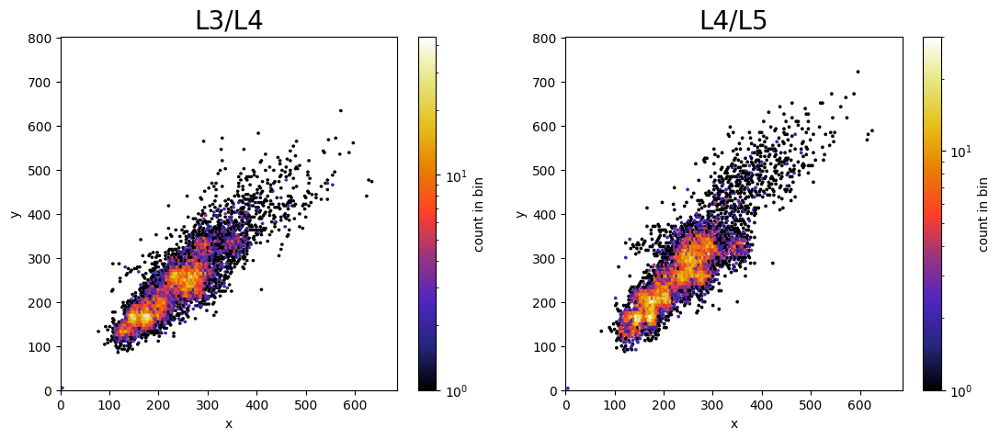

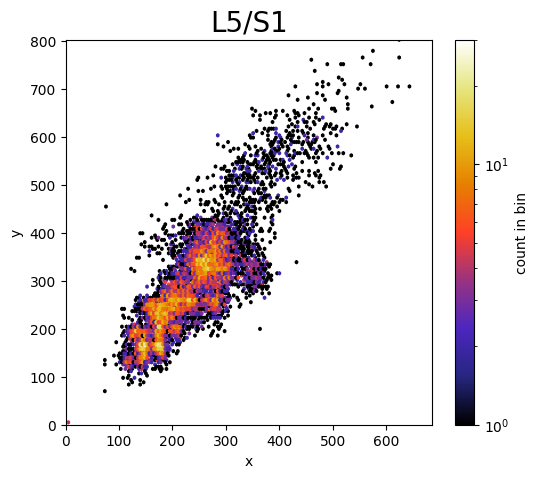

In [8]:
# Density Plots by Level
p = ['#4600c0','#00a419','#111111','#ffff00','#ff0000']
plt.figure(figsize=(5,5))
sns.scatterplot(data=df_train, x='x', y='y', hue='level',
                palette=p, s=20, alpha=0.3)
plt.legend(
    bbox_to_anchor=(1.2,1), loc=2,
    prop={'size':10}, markerscale=2,
    framealpha=0.8, facecolor='white', reverse=True
)
plt.grid()
plt.xlim(0, df_train.x.max())
plt.ylim(0, df_train.y.max())
plt.show()

levels = df_train.level.unique()
figs_x, figs_y = 13, 5
Label_size, Title_size = 10, 20
plt.figure(figsize=(figs_x, figs_y))
plt.suptitle('xy-Density of cases by level',fontsize=Title_size+2,y=1.02)
k = 1
for lvl in levels:
    d = df_train[df_train.level == lvl]
    plt.subplot(1, n, k)
    plt.hexbin(x=d.x, y=d.y, gridsize=gs, cmap='CMRmap', bins='log', alpha=1)
    plt.colorbar().set_label('count in bin', size=10)
    plt.xlabel('x', fontsize=Label_size)
    plt.ylabel('y', fontsize=Label_size)
    plt.title(lvl, fontsize=Title_size)
    plt.xlim(0, df_train.x.max())
    plt.ylim(0, df_train.y.max())
    k += 1
    if k > n:
        plt.show()
        plt.figure(figsize=(figs_x, figs_y))
        k = 1

<a id="section6"></a>
## 6. Density by Series Description

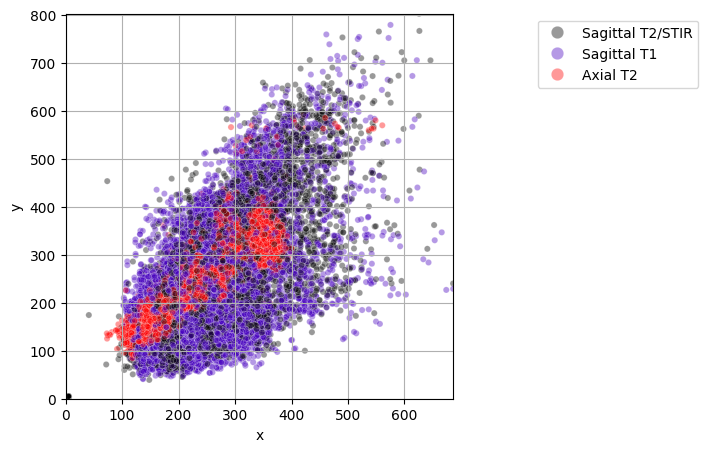

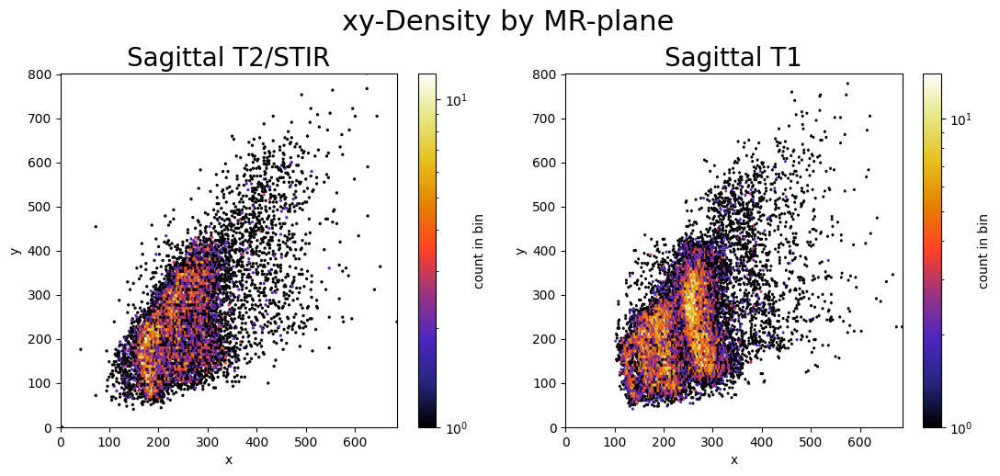

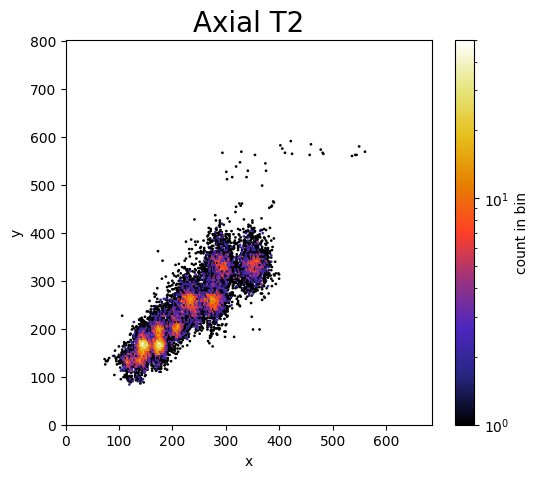

In [9]:
# Density Plots by Series Description
p = ['#000000','#4600c0','#ff0000']
plt.figure(figsize=(5,5))
sns.scatterplot(data=df_train, x='x', y='y', hue='series_description',
                palette=p, s=20, alpha=0.4)
plt.legend(
    bbox_to_anchor=(1.2,1), loc=2,
    prop={'size':10}, markerscale=2,
    framealpha=0.8, facecolor='white'
)
plt.grid()
plt.xlim(0, df_train.x.max())
plt.ylim(0, df_train.y.max())
plt.show()

series = df_train.series_description.unique()
figs_x, figs_y = 13, 5
Label_size, Title_size = 10, 20
plt.figure(figsize=(figs_x, figs_y))
plt.suptitle('xy-Density by MR-plane',fontsize=Title_size+2,y=1.02)
k = 1
for ser in series:
    d = df_train[df_train.series_description == ser]
    plt.subplot(1, n, k)
    plt.hexbin(x=d.x, y=d.y, gridsize=200, cmap='CMRmap', bins='log', alpha=1)
    plt.colorbar().set_label('count in bin', size=10)
    plt.xlabel('x', fontsize=Label_size)
    plt.ylabel('y', fontsize=Label_size)
    plt.title(ser, fontsize=Title_size)
    plt.xlim(0, df_train.x.max())
    plt.ylim(0, df_train.y.max())
    k += 1
    if k > n:
        plt.show()
        plt.figure(figsize=(figs_x, figs_y))
        k = 1

<a id="section7"></a>
## 7. Target Distribution (pie & bar)

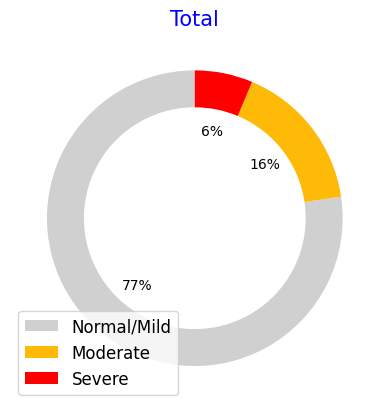

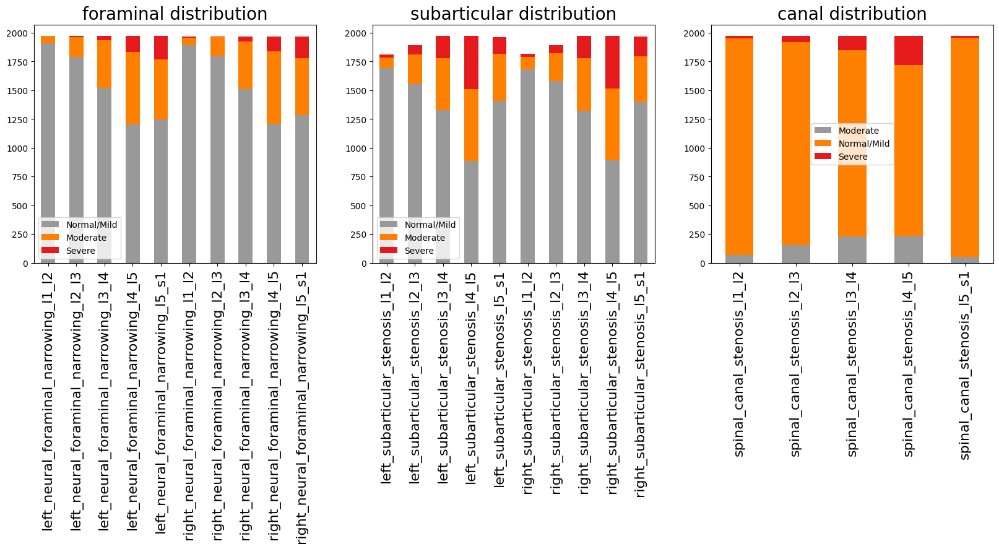

In [10]:
# Target Distribution
train_label_df = df_train_label.copy()
train_data_df  = df_train_main.copy()
train_label_df['new_col'] = (
    train_label_df.condition.str.lower().str.replace(' ', '_')
  + '_' +
    train_label_df.level.str.lower().str.replace('/', '_')
)
def get_target(row):
    return train_data_df.loc[
        train_data_df.study_id == row.study_id, row.new_col
    ].values[0]
train_label_df['target'] = train_label_df.apply(get_target, axis=1)
final_train_df = train_label_df.copy()

# Pie chart overall
names = ['Normal/Mild','Moderate','Severe']
p = ['#d0d0d0','#ffba07','#ff0000']
plt.pie(
    final_train_df.target.value_counts(normalize=True),
    autopct='%1.f%%', colors=sns.color_palette(p),
    startangle=90, wedgeprops=dict(width=0.25)
)
plt.title('Total', color='blue', fontsize=15)
plt.legend(names, loc='lower left', prop={'size':12})
plt.show()

# Bar charts per L/L split
fig, axes = plt.subplots(1, 3, figsize=(20,5))
for idx, d in enumerate(['foraminal','subarticular','canal']):
    diag_cols = [c for c in df_train_main.columns if d in c.lower()]
    vc = df_train_main[diag_cols].apply(pd.value_counts).fillna(0).T
    vc.plot(kind='bar', stacked=True, ax=axes[idx], cmap='Set1_r')
    axes[idx].tick_params(axis='x', labelsize=16)
    axes[idx].set_title(f"{d} distribution", fontsize=20)
plt.show()

<a id="section8"></a>
## 8. Sample MR-Image Overlays

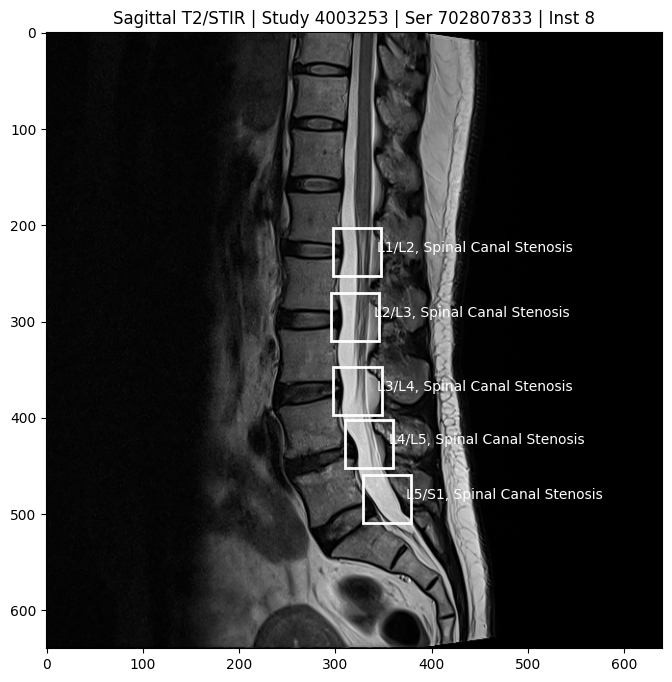

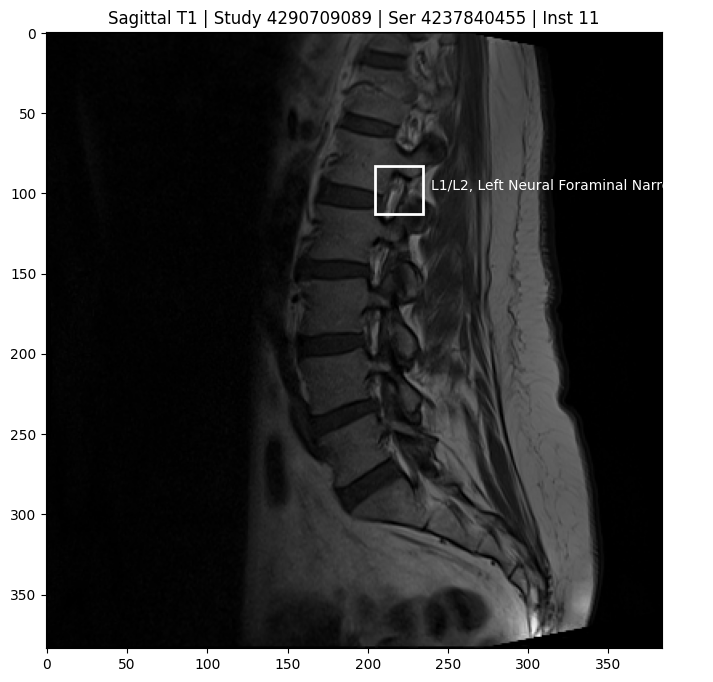

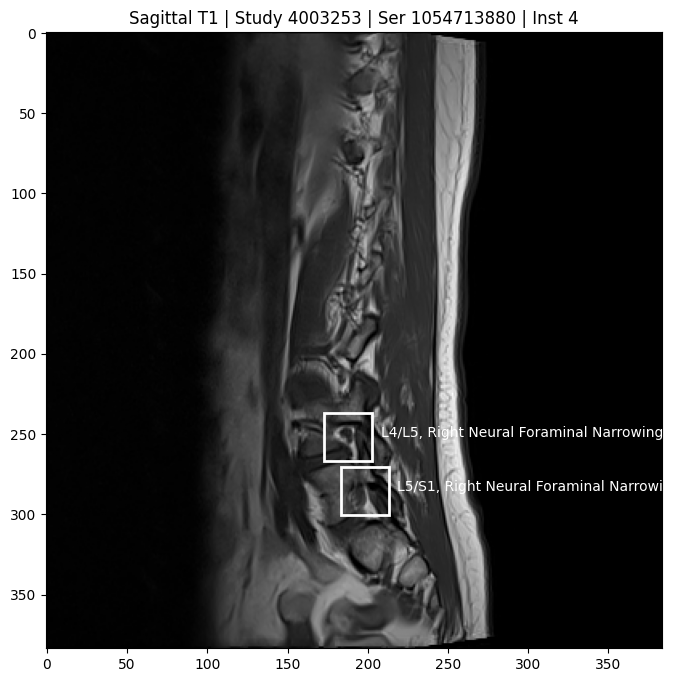

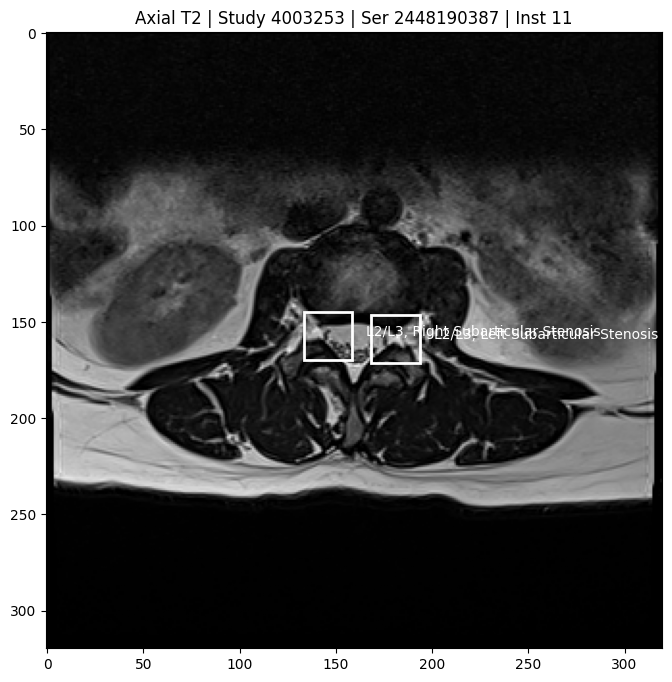

In [13]:
# Sample MR-Image Overlays
import matplotlib.patches as patches

train_label_coordinates = df_train_label.copy()
train_label_coordinates['series_description'] = df_train.series_description

def mrt(id, ser, inst):
    path2 = f"{path}train_images/{id}/{ser}/{inst}.dcm"
    ds = pydicom.dcmread(path2)
    fig, ax = plt.subplots(figsize=(16,8))
    ax.imshow(ds.pixel_array, cmap='gray')

    subset = train_label_coordinates.query(
        'study_id==@id & series_id==@ser & instance_number==@inst'
    )
    a = 25 * max(ds.pixel_array.shape) / 640
    for _, row in subset.iterrows():
        x, y = row.x, row.y
        rect = patches.Rectangle((x-a,y-a),2*a,2*a,
                                 linewidth=2,edgecolor='white',facecolor='none')
        ax.add_patch(rect)
        ax.text(x+20, y, f"{row.level}, {row.condition}", fontsize=10, color='white')

    ax.set_title(
        f"{subset.series_description.unique()[0]} | Study {id} | Ser {ser} | Inst {inst}"
    )
    plt.show()

# example cases
cases = [
    (4003253,702807833,8),
    (4290709089,4237840455,11),
    (4003253,1054713880,4),
    (4003253,2448190387,11)
]
for id, ser, inst in cases:
    mrt(id, ser, inst)

<a id="section9"></a>
## 9. 3D MR Slide Animation

In [14]:
# 3D MR Slide Animation
from matplotlib import rc
rc('animation', html='jshtml')

def MR3d(id, ser):
    folder = f"{path}train_images/{id}/{ser}"
    files  = sorted(glob.glob(os.path.join(folder, "*.dcm")),
                    key=lambda x:int(os.path.splitext(os.path.basename(x))[0]))
    images = []
    for fn in files:
        arr = pydicom.dcmread(fn).pixel_array
        if arr.max()>0:
            images.append((arr-arr.min())/arr.max())

    def animate(i):
        im.set_array(images[i])
        text.set_text(f"Slide {i+1}")
        return im, text

    fig = plt.figure(figsize=(6,6))
    plt.axis('off')
    im   = plt.imshow(images[0], cmap='gray')
    text = plt.text(0.05,0.05,'Slide 1', transform=fig.transFigure,
                    fontsize=16, color='darkblue')
    anim = animation.FuncAnimation(
        fig, animate, frames=len(images), interval=100
    )
    plt.close()
    return anim

# animate a few series
series_cases = [
    (4003253,702807833),
    (4290709089,4237840455),
    (4003253,1054713880),
    (4003253,2448190387)
]
for id, ser in series_cases:
    display(MR3d(id, ser))